# Data Exploration

In the presented notebook we will try to explore the data and get some first insights around it.
* Analyze possible for anomalies
* Analyze tendencies 
* Explore possible collinearity between vairables
* Outliers

In [227]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from datetime import datetime
from matplotlib import pyplot
import altair as alt
from matplotlib.pyplot import figure
from matplotlib.axes._axes import _log as matplotlib_axes_logger
import pycountry
from matplotlib import pyplot as plt
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
import pygal
from pygal.maps.world import World
from IPython.core.display import display, HTML
matplotlib_axes_logger.setLevel('ERROR')
sns.set_theme(style="white")
alt.data_transformers.enable('default', max_rows=None)
plt.rcParams["figure.figsize"] = (20,10)

# Authenticate to Google Drive
(Request access to lucasbotellaroca@gmail.com if not conceded)

In [228]:
# A browser window will open. Login using the appropriate account.
gauth = GoogleAuth()
gauth.LocalWebserverAuth() #

Your browser has been opened to visit:

    https://accounts.google.com/o/oauth2/auth?client_id=267819126046-3da5rmgml4iemor49ermcv23tnaj02t5.apps.googleusercontent.com&redirect_uri=http%3A%2F%2Flocalhost%3A8080%2F&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive&access_type=offline&response_type=code

Authentication successful.


In [229]:
drive = GoogleDrive(gauth)

In [230]:
drive

In [231]:
def read_csv_file(folder, fileName, nrows):
    
    read_file = drive.ListFile({'q': "title contains '" + fileName + ".csv' and '" + folder + "' in parents"}).GetList()
    
    if len(read_file)>0:
        title = read_file[0]['title']
        id = read_file[0]['id']
        each_file = drive.CreateFile({'id': id})
        each_file.GetContentFile(title)
        df = pd.read_csv(title, skiprows=nrows)
    else:
        
        df=pd.DataFrame()
    
    return df

## Read file and prepare data

In [233]:
#df=pd.read_csv('../df_covid_processed_final_reproduction_rate.csv')
df=read_csv_file('1kNVBQTd_m6OihGl5zXfkcbin9BtKzFEw','df_covid_processed_final_reproduction_rate',0)

#Selected columns for our analysis
df=df[['Code', 'Date', 'retail_and_recreation',
       'grocery_and_pharmacy', 'residential', 'transit_stations', 'parks',
       'workplaces', 'debt_relief', 'income_support', 'testing_policy',
       'international_travel_controls', 'restrictions_internal_movements',
       'close_public_transport', 'public_information_campaigns',
       'facial_coverings', 'contact_tracing', 
       'stay_home_requirements', 'restriction_gatherings',
       'cancel_public_events', 'workplace_closures', 'school_closures',
       'holiday', 'temp', 'prcp', 'number_of_arrivals', 'urban_population',
      'total_vaccinations_per_100', 'youth_unemployment','infections_value',
      'accumulated', 'reproduction_rate_week_n-1', 'reproduction_rate']]

df

,Code,Date,retail_and_recreation,grocery_and_pharmacy,residential,transit_stations,parks,workplaces,debt_relief,income_support,...,temp,prcp,number_of_arrivals,urban_population,total_vaccinations_per_100,youth_unemployment,infections_value,accumulated,reproduction_rate_week_n-1,reproduction_rate
0,AUS,2020-03-22,0.714429,8.979571,-0.387571,5.448857,-2.857143,8.326571,0.000000,0.0,...,21.346512,0.142010,8263000.0,85.904,NaN,11.84,7.28,0.002502,2.170000,2.170000
1,AUS,2020-03-29,-0.898000,15.163286,0.448857,-1.061286,-4.959143,6.959000,0.000000,1.0,...,21.176835,0.054789,8263000.0,85.904,NaN,11.84,12.13,0.003071,2.170000,2.330000
2,AUS,2020-04-05,-10.591857,22.020286,5.102143,-21.836714,-14.836714,-0.918286,0.285714,1.0,...,20.702945,0.051898,8263000.0,85.904,NaN,11.84,11.31,0.003808,2.330000,2.280000
3,AUS,2020-04-12,-32.163429,-0.020429,13.428429,-48.775571,-28.183714,-22.816286,2.000000,1.0,...,21.093375,0.073336,8263000.0,85.904,NaN,11.84,6.36,0.005034,2.280000,1.457143
4,AUS,2020-04-19,-40.918429,-12.347143,17.612143,-60.204143,-39.326571,-35.265286,2.000000,1.0,...,18.880697,0.118556,8263000.0,85.904,NaN,11.84,2.95,0.006178,1.457143,0.765714
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3581,USA,2021-04-04,-8.816429,-4.244714,7.040714,-27.183571,4.265286,-25.775714,1.000000,2.0,...,7.624732,0.073711,75608000.0,82.058,36.955714,8.30,NaN,0.239994,0.941429,1.021429
3582,USA,2021-04-11,-8.469429,-4.000143,6.632286,-26.163143,12.040857,-24.877429,1.000000,2.0,...,10.027194,0.090106,75608000.0,82.058,42.600000,8.30,NaN,0.239994,1.021429,1.074286
3583,USA,2021-04-18,-8.020429,-0.142857,6.449143,-25.469286,17.755000,-27.979714,1.000000,2.0,...,8.969289,0.076530,75608000.0,82.058,48.920000,8.30,NaN,0.239994,1.074286,1.047143
3584,USA,2021-04-25,-7.979571,-1.816286,5.816143,-24.571429,24.347000,-26.428571,1.000000,2.0,...,8.969289,0.076530,75608000.0,82.058,55.571429,8.30,NaN,0.239994,1.047143,1.042857


- 3586 and 32 columns before doing any filtering, nan treatment or feature engineering.

In [234]:
df.columns

Index(['Code', 'Date', 'retail_and_recreation', 'grocery_and_pharmacy',
       'residential', 'transit_stations', 'parks', 'workplaces', 'debt_relief',
       'income_support', 'testing_policy', 'international_travel_controls',
       'restrictions_internal_movements', 'close_public_transport',
       'public_information_campaigns', 'facial_coverings', 'contact_tracing',
       'stay_home_requirements', 'restriction_gatherings',
       'cancel_public_events', 'workplace_closures', 'school_closures',
       'holiday', 'temp', 'prcp', 'number_of_arrivals', 'urban_population',
       'total_vaccinations_per_100', 'youth_unemployment', 'infections_value',
       'accumulated', 'reproduction_rate_week_n-1', 'reproduction_rate'],
      dtype='object')

In [235]:
df.describe()

,retail_and_recreation,grocery_and_pharmacy,residential,transit_stations,parks,workplaces,debt_relief,income_support,testing_policy,international_travel_controls,...,temp,prcp,number_of_arrivals,urban_population,total_vaccinations_per_100,youth_unemployment,infections_value,accumulated,reproduction_rate_week_n-1,reproduction_rate
count,3584.000000,3584.000000,3586.000000,3586.000000,3581.000000,3586.000000,3586.000000,3586.000000,3586.000000,3586.000000,...,3410.000000,3410.000000,3.528000e+03,3528.000000,849.000000,3528.000000,2263.000000,3528.000000,3586.000000,3586.000000
mean,-28.410933,-6.491111,9.508315,-32.531094,6.666821,-25.589656,1.270297,1.386503,2.050434,2.857143,...,14.636611,0.076246,1.328493e+07,72.395179,10.812959,13.953719,16.781595,0.058582,1.098795,1.081512
std,21.810630,17.348371,8.200507,19.735015,56.299885,15.035329,0.723047,0.680400,0.704011,0.962999,...,10.096002,0.103772,1.860506e+07,15.807962,16.686201,7.825345,28.123202,0.077572,0.396710,0.366175
min,-91.245143,-81.979714,-10.020286,-88.428571,-84.673286,-81.408143,0.000000,0.000000,0.000000,0.000000,...,-26.823256,0.000000,1.210000e+05,36.135000,0.000000,0.470000,-95.590000,0.000000,0.010000,0.010000
25%,-42.596750,-13.954179,3.433643,-45.648000,-27.999857,-33.219250,1.000000,1.000000,2.000000,2.000000,...,6.970889,0.011373,2.292000e+06,58.299000,0.855714,8.510000,0.895000,0.006316,0.902857,0.900000
50%,-25.428690,-4.020357,8.591714,-31.642786,-6.898000,-23.693786,1.000000,1.714286,2.000000,3.000000,...,15.251876,0.042509,5.967000e+06,74.669000,4.631429,11.400000,7.860000,0.024298,1.058571,1.051429
75%,-12.275500,2.474500,13.877429,-18.775357,24.142857,-16.122464,2.000000,2.000000,3.000000,4.000000,...,22.982237,0.101032,1.582800e+07,85.325000,14.265714,17.090000,24.570000,0.084712,1.237143,1.222857
max,50.857286,79.551000,41.163143,71.652857,400.122571,35.918286,2.000000,2.000000,3.000000,4.000000,...,37.482906,1.207661,8.257000e+07,100.000000,120.655000,35.110001,409.190000,0.427355,4.285000,4.285000


In [236]:
df.isna().sum()

Code                                  0
Date                                  0
retail_and_recreation                 2
grocery_and_pharmacy                  2
residential                           0
transit_stations                      0
parks                                 5
workplaces                            0
debt_relief                           0
income_support                        0
testing_policy                        0
international_travel_controls         0
restrictions_internal_movements       0
close_public_transport                0
public_information_campaigns          0
facial_coverings                      0
contact_tracing                       0
stay_home_requirements                0
restriction_gatherings                0
cancel_public_events                  0
workplace_closures                    0
school_closures                       0
holiday                               0
temp                                176
prcp                                176


* Temperature and precipitation contain 176 nulls values.
* "total_vaccinations_per_100" contains 2737 nulls, willreplace them by zeros, meaning no vaccines administered.
* infectious value cotains 1323, will simply drop those entries since there is no excess mortality recorded for those entries, hence it would affect our predictions, since inmunity is important in the spread of the virus.

In [237]:
df = df[df['infections_value'].notna()]
df = df[df['accumulated'].notna()]
df['total_vaccinations_per_100'] = df['total_vaccinations_per_100'].fillna(0)
df['infections_value'][df['infections_value'] < 0] = 0

<ipython-input-237-71263b5c057b>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['infections_value'][df['infections_value'] < 0] = 0


* After treating data and managing null values we are left with the following dataset

In [238]:
df

,Code,Date,retail_and_recreation,grocery_and_pharmacy,residential,transit_stations,parks,workplaces,debt_relief,income_support,...,temp,prcp,number_of_arrivals,urban_population,total_vaccinations_per_100,youth_unemployment,infections_value,accumulated,reproduction_rate_week_n-1,reproduction_rate
0,AUS,2020-03-22,0.714429,8.979571,-0.387571,5.448857,-2.857143,8.326571,0.000000,0.0,...,21.346512,0.142010,8263000.0,85.904,0.000000,11.84,7.28,0.002502,2.170000,2.170000
1,AUS,2020-03-29,-0.898000,15.163286,0.448857,-1.061286,-4.959143,6.959000,0.000000,1.0,...,21.176835,0.054789,8263000.0,85.904,0.000000,11.84,12.13,0.003071,2.170000,2.330000
2,AUS,2020-04-05,-10.591857,22.020286,5.102143,-21.836714,-14.836714,-0.918286,0.285714,1.0,...,20.702945,0.051898,8263000.0,85.904,0.000000,11.84,11.31,0.003808,2.330000,2.280000
3,AUS,2020-04-12,-32.163429,-0.020429,13.428429,-48.775571,-28.183714,-22.816286,2.000000,1.0,...,21.093375,0.073336,8263000.0,85.904,0.000000,11.84,6.36,0.005034,2.280000,1.457143
4,AUS,2020-04-19,-40.918429,-12.347143,17.612143,-60.204143,-39.326571,-35.265286,2.000000,1.0,...,18.880697,0.118556,8263000.0,85.904,0.000000,11.84,2.95,0.006178,1.457143,0.765714
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3572,USA,2021-01-31,-24.673429,-12.857143,10.795714,-40.183714,-19.183714,-28.816286,1.000000,2.0,...,3.141409,0.027324,75608000.0,82.058,4.160000,8.30,28.11,0.217541,1.045714,0.892857
3573,USA,2021-02-07,-25.836714,-14.142714,10.734429,-41.285714,-21.000143,-28.816143,1.000000,2.0,...,1.441940,0.060531,75608000.0,82.058,6.405714,8.30,25.01,0.223260,0.892857,0.848571
3574,USA,2021-02-14,-25.938714,-14.551000,10.714000,-41.714286,-25.775714,-27.938714,1.000000,2.0,...,0.586187,0.055322,75608000.0,82.058,9.125714,8.30,15.60,0.228214,0.848571,0.825714
3575,USA,2021-02-21,-24.489857,-12.326571,10.142857,-40.591714,-23.285714,-27.489714,1.000000,2.0,...,-1.192456,0.032941,75608000.0,82.058,12.074286,8.30,12.85,0.232621,0.825714,0.780000


In [239]:
df.isna().sum()

Code                                0
Date                                0
retail_and_recreation               0
grocery_and_pharmacy                0
residential                         0
transit_stations                    0
parks                               3
workplaces                          0
debt_relief                         0
income_support                      0
testing_policy                      0
international_travel_controls       0
restrictions_internal_movements     0
close_public_transport              0
public_information_campaigns        0
facial_coverings                    0
contact_tracing                     0
stay_home_requirements              0
restriction_gatherings              0
cancel_public_events                0
workplace_closures                  0
school_closures                     0
holiday                             0
temp                               70
prcp                               70
number_of_arrivals                  0
urban_popula

* 2224 rows with 33 columns
* Only 70 null values on temperature and precipitation

### Countries included in the Analysis

In [240]:
def country_name(country):
    return pycountry.countries.get(alpha_3=country).name
def country_code_2_lower(country):
    return pycountry.countries.get(alpha_3=country).alpha_2.lower()

In [241]:
country_list=df.Code.unique()
country_names_list=[country_name(country) for country in country_list]
country_names_list_code2_lower=[country_code_2_lower(country) for country in country_list]

In [242]:
worldmap_chart = World()

worldmap_chart.title = 'Countries included in the analysis'

for i in range(len(country_names_list)):
    worldmap_chart.add(country_names_list[i], country_names_list_code2_lower[i])
    
worldmap_chart.render_to_file('mymap.html')

In [243]:
display(HTML(worldmap_chart.render(is_unicode=True)))

In [244]:
df.Code.unique().size

61

* There is a total of 61 countries in our data set.
* Most of countries in Europe and North America are included.
* Very few data on African and Asian countries.

### Correlation Matrix

<AxesSubplot:>

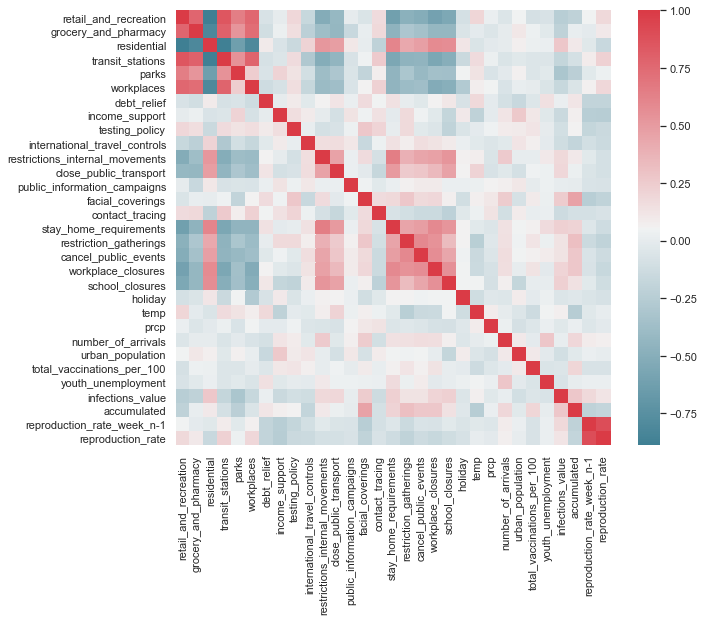

In [245]:
f, ax = plt.subplots(figsize=(10, 8))
corr = df.corr()
sns.heatmap(corr, mask=np.zeros_like(corr, dtype=np.bool), cmap=sns.diverging_palette(220, 10, as_cmap=True),
            square=True, ax=ax)

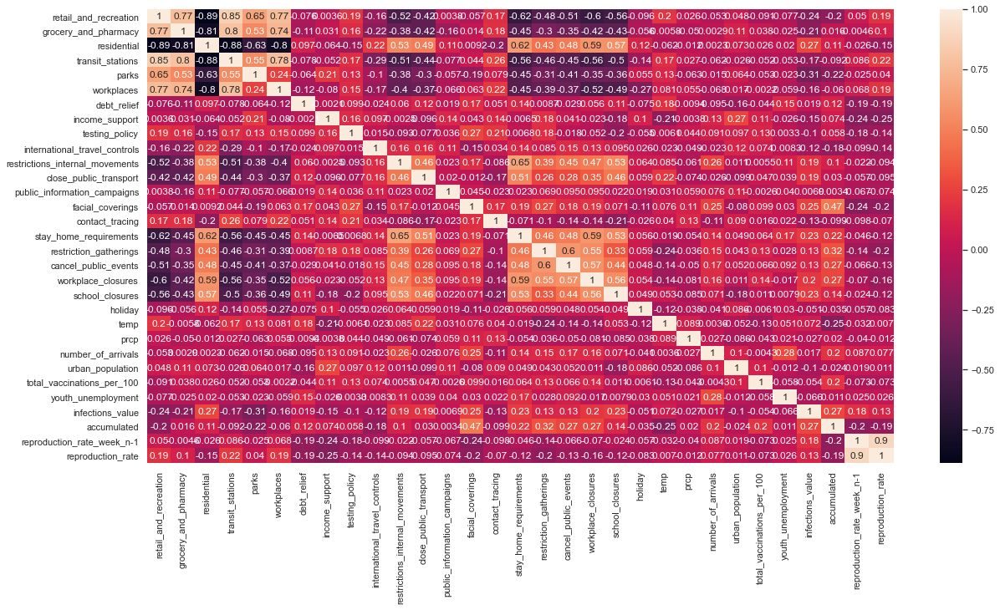

In [246]:
corrMatrix = df.corr()
sns.heatmap(corrMatrix, annot=True)
plt.show()

In [247]:
np.abs(corrMatrix['reproduction_rate']).sort_values(ascending=False)

reproduction_rate                  1.000000
reproduction_rate_week_n-1         0.902925
income_support                     0.248566
transit_stations                   0.219056
restriction_gatherings             0.201778
facial_coverings                   0.196144
workplaces                         0.193121
debt_relief                        0.191897
retail_and_recreation              0.186847
accumulated                        0.185473
workplace_closures                 0.162095
residential                        0.154993
testing_policy                     0.144106
international_travel_controls      0.138480
cancel_public_events               0.132350
infections_value                   0.126105
stay_home_requirements             0.122146
school_closures                    0.118839
grocery_and_pharmacy               0.103774
close_public_transport             0.094971
restrictions_internal_movements    0.093682
holiday                            0.082712
number_of_arrivals              

* There is a high multicollinearity between variables, Mobility trends are highly correlated with each other values close to 1
* There is also a high multicollinearity in restrictions, meaning restrictions are applied together
* Even more, there is multicollinearity between mobility trends and restrictions, which is something expected.
* Restrictions that most affect mobility seem to be "stay_at_home_requirements", "restrictions_gatherings", "cancel_public_events", "workplace_closures" and "school_closures"
* Our target variable "reproduction_rate"  highest collinearity is mainly with mobility trends.
* reproduction_rate_week_n-1 has a collinearity of 0.9 with our target variable.

### Multicollinearity VIF Analysis

In [248]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [249]:
df_aux_vif=df.dropna()
df_aux_vif=df_aux_vif[~df_aux_vif.isin([np.inf, -np.inf]).any(1)]
vif_data=pd.DataFrame()
vif_data["VIF"] = [variance_inflation_factor(df_aux_vif[df_aux_vif.columns[2:-1]].values, i)
                          for i in range(len(df_aux_vif[df_aux_vif.columns[2:-1]].columns))]
vif_data.index=df_aux_vif.columns[2:-1]
print(vif_data)

                                       VIF
retail_and_recreation            22.881122
grocery_and_pharmacy              5.687472
residential                      32.866171
transit_stations                 29.984583
parks                             4.393769
workplaces                       32.964809
debt_relief                       5.821852
income_support                   10.308187
testing_policy                   13.461176
international_travel_controls    15.011507
restrictions_internal_movements   5.408263
close_public_transport            3.187803
public_information_campaigns     74.861485
facial_coverings                  7.528474
contact_tracing                   9.601202
stay_home_requirements            7.784561
restriction_gatherings           20.367127
cancel_public_events             17.905268
workplace_closures               16.165896
school_closures                  13.615142
holiday                           1.482046
temp                              4.915933
prcp       

In [250]:
vif_data[vif_data['VIF']>5].count()

VIF    21
dtype: int64

* VIF values with vif>5 are said to be values with very high correlation, therefore, most of our dataset contains high correlation, 20 out of 33 columns have high correlation.
* As seen lots of variables have very high VIF values, therefore based on the correlaion matrix and the presented VIF analysis, there is lot of multicollineaity between variables.

In [251]:
vif_data[vif_data['VIF']>5].index

Index(['retail_and_recreation', 'grocery_and_pharmacy', 'residential',
       'transit_stations', 'workplaces', 'debt_relief', 'income_support',
       'testing_policy', 'international_travel_controls',
       'restrictions_internal_movements', 'public_information_campaigns',
       'facial_coverings', 'contact_tracing', 'stay_home_requirements',
       'restriction_gatherings', 'cancel_public_events', 'workplace_closures',
       'school_closures', 'urban_population', 'youth_unemployment',
       'reproduction_rate_week_n-1'],
      dtype='object')

Those variables are mainly:
* Mobility Indexes: 
       'retail_and_recreation', 'grocery_and_pharmacy', 'residential',
       'transit_stations', 'workplaces'
* Government Measures: 
       'debt_relief', 'income_support',
       'testing_policy', 'international_travel_controls',
       'restrictions_internal_movements', 'public_information_campaigns',
       'facial_coverings', 'contact_tracing', 'stay_home_requirements',
       'restriction_gatherings', 'cancel_public_events', 'workplace_closures',
       'school_closures'

* Approach to reduce multicollinerity is grouping variables with high correlation.

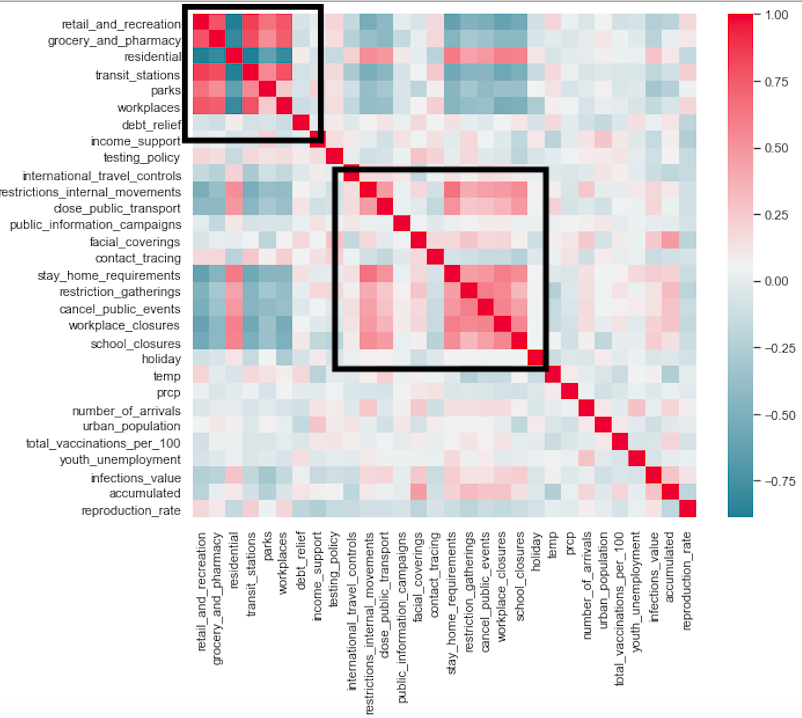

* Those set of variables will be grouped under one single group since they have high correlation.

In [252]:
df_appch2=df.copy()
df_appch2['mobility_index']=(df_appch2['retail_and_recreation']*0.4+df_appch2['transit_stations']*0.4
                           +df_appch2['grocery_and_pharmacy']*0.1+df_appch2['workplaces']*0.1)

df_appch2['awareness_measures'] = df_appch2['public_information_campaigns']*0.2+df_appch2['facial_coverings']*0.8

df_appch2['economic_measures']=df_appch2['debt_relief']*0.5+df_appch2['income_support']*0.5
df_appch2['health_measures']=df_appch2['contact_tracing']*0.5+df_appch2['testing_policy']*0.5
df_appch2['mobility_measures']=0.3*df_appch2['stay_home_requirements']\
                                + 0.3*df_appch2['restriction_gatherings']\
                                + 0.2*df_appch2['restrictions_internal_movements']\
                                + 0.1*df_appch2['international_travel_controls']\
                                + 0.1*df_appch2['close_public_transport']\
                                + 0.2*df_appch2['cancel_public_events']\
                                + 0.4*df_appch2['workplace_closures']\
                                + 0.4*df_appch2['school_closures']

df_appch2=df_appch2[['Code', 'Date','mobility_index', 'residential',
                     'awareness_measures', 'health_measures',
                     'mobility_measures', 'economic_measures',

                     'holiday', 'temp', 'prcp', 
                     'number_of_arrivals', 'urban_population',
                     'total_vaccinations_per_100', 'youth_unemployment',
                     'infections_value', 'accumulated', 'reproduction_rate']]

<AxesSubplot:>

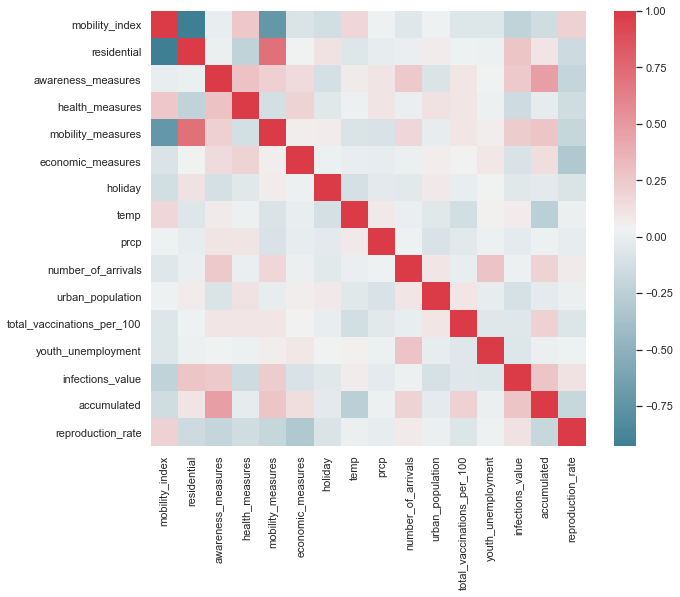

In [253]:
f, ax = plt.subplots(figsize=(10, 8))
corr = df_appch2.corr()
sns.heatmap(corr, mask=np.zeros_like(corr, dtype=np.bool), cmap=sns.diverging_palette(220, 10, as_cmap=True),
            square=True, ax=ax)

* After grouping we are left with the correlation matrix shown above that still has some linear correlations.

In [254]:
df_aux_vif=df_appch2.dropna()
df_aux_vif=df_aux_vif[~df_aux_vif.isin([np.inf, -np.inf]).any(1)]
vif_data=pd.DataFrame()
vif_data["VIF"] = [variance_inflation_factor(df_aux_vif[df_aux_vif.columns[2:-1]].values, i)
                          for i in range(len(df_aux_vif[df_aux_vif.columns[2:-1]].columns))]
vif_data.index=df_aux_vif.columns[2:-1]
print(vif_data)

                                  VIF
mobility_index              31.473371
residential                 23.827552
awareness_measures           9.197106
health_measures             16.921154
mobility_measures           23.989552
economic_measures           10.918390
holiday                      1.242449
temp                         3.691468
prcp                         1.736480
number_of_arrivals           2.005755
urban_population            19.077051
total_vaccinations_per_100   1.139365
youth_unemployment           4.910083
infections_value             1.874599
accumulated                  2.901287


* As seen even after transformation and grouping of variables VIF values are high and multicollinearity is still existing.

### Features Distribution Plots

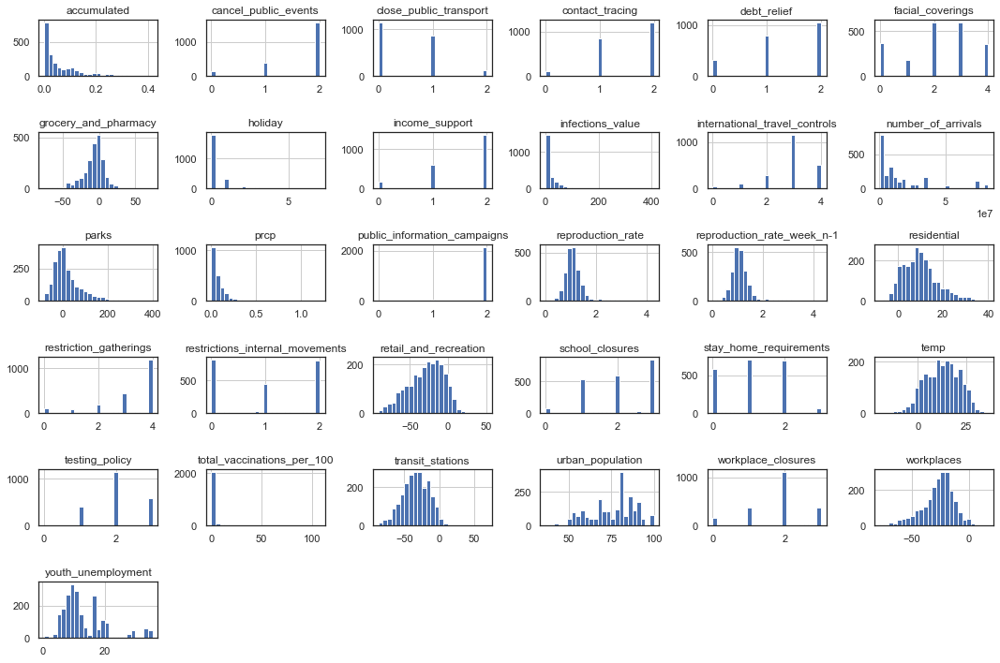

In [255]:
df.hist(bins=25, figsize=(15,10))
plt.tight_layout()
plt.show()

* There is set of numerical variables that are represented as "categorical". Restrictions as detailed have a discrete set of value most of them ranging from 0 to 3 in most cases. A more in detail description of the possible values this variables are capturing is detailed in the memory.pdf document.
* Restrictions are dicretized however the numerical values associated have a sense, lower values represent low restrictions, higher values represent strict restrictions.
* "prcp", "total_vaccinations" and "accumulated" seem to be skewed.

### Reproduction Rate Distribution 

Text(0.5, 1.0, 'reproduction_rate')

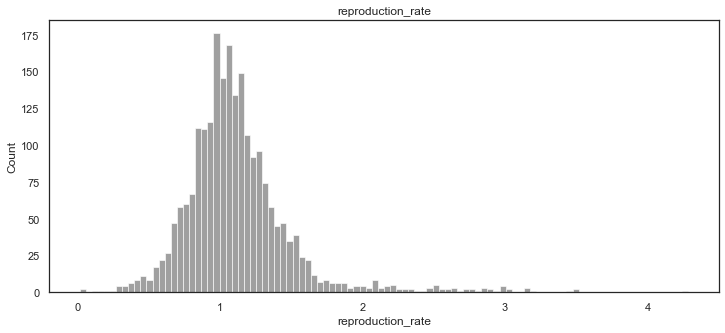

In [137]:
#Removing -inf and infinite
df=df[~df.isin([np.inf, -np.inf]).any(1)]
f, axes = plt.subplots(figsize=(12,5))
sns.histplot(x='reproduction_rate', data=df, kde=False, bins=100, ax=axes, color='grey');
axes.set_title('reproduction_rate')

In [138]:
df[['reproduction_rate']].describe()

,reproduction_rate
count,2224.000000
mean,1.121640
std,0.386518
min,0.017143
25%,0.910000
50%,1.067143
75%,1.261429
max,4.285000


* Our target variable ranges from 0 to 4.28 containing 50% of its values in range [0.9, 1.26]. This might be due to governments trying to find reproduction_rate of 1 constantly
* Values higher or equal to 2 refer to uncontrolled moments in the epidemic

<ipython-input-162-d76727e39dfe>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_acc['Date'] = pd.to_datetime(df_acc['Date'])


<AxesSubplot:xlabel='Date'>

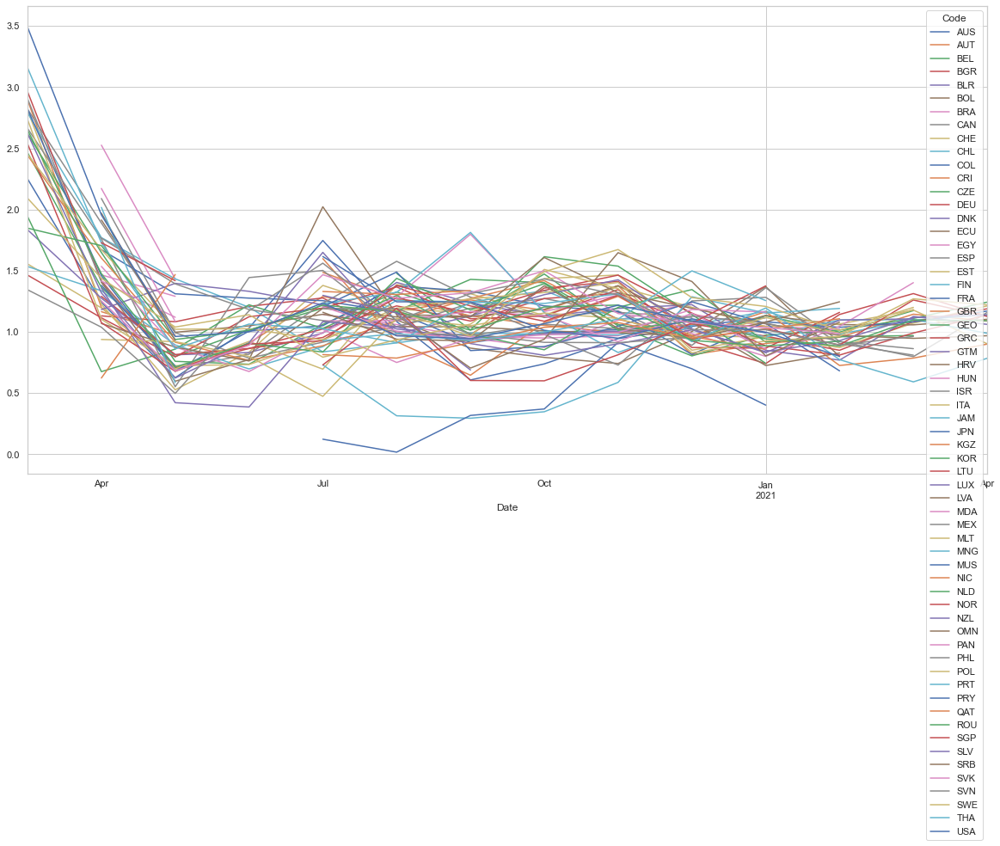

In [162]:
df_acc=df[['Code', 'Date', 'reproduction_rate']]
df_acc['Date'] = pd.to_datetime(df_acc['Date'])
df_acc=df_acc.groupby(by=[df_acc['Date'].dt.to_period('m'), df_acc['Code']]).mean().reset_index()
df_acc=df_acc.pivot(index="Date",columns="Code",values="reproduction_rate")
df_acc.plot()

* As it can be well appreciated reproduction rate values tend to be stabalized and its range of values tends to increasingly be closer to 1 as time passes.
* This might be due to governments trying to aim to fit the perfect reproduction rate of 1 and its decisions being more precise as time passes.
* It can be seen how highest values of reproduction rate are recorded in the beginning of the epidemic were no measures were taken and mobility trends were very large.

In [256]:
alt.Chart(df).mark_point().encode(
    x='reproduction_rate_week_n-1',
    y='reproduction_rate'
)

alt.Chart(...)

* As it can be seen values of reproduction rate in week n-1 is highly correlated with value in week n.
* It can be appreciated in the correlation matrix as well with a correlation of 0.9

### Reproduction rate distribution per country 

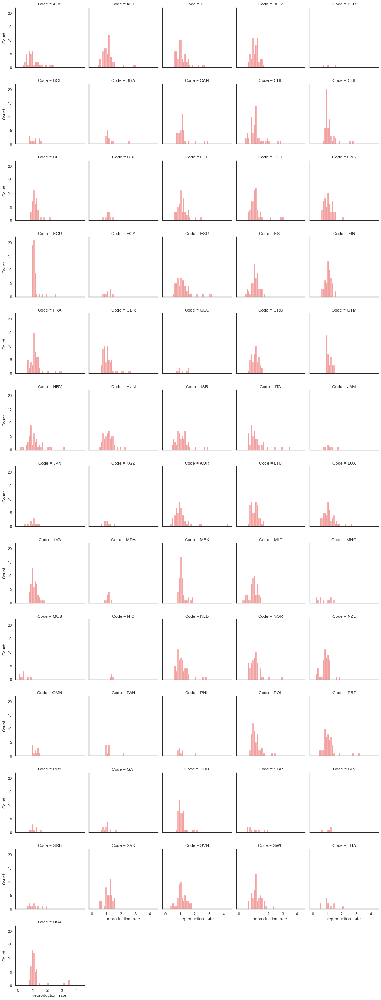

In [139]:
sns.displot(
    df, x="reproduction_rate", col="Code", col_wrap=5, kind='hist',
    binwidth=0.1, height=3, color='lightcoral');
plt.tight_layout()

### Restrictions

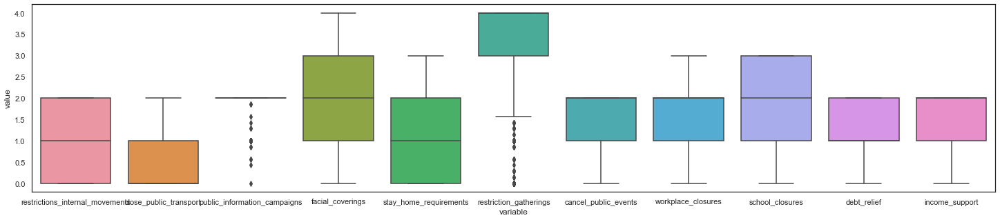

In [140]:
plt.subplots(figsize=(25,5))

df_restrictions=df[['restrictions_internal_movements', 'close_public_transport',
       'public_information_campaigns', 'facial_coverings',
       'stay_home_requirements', 'restriction_gatherings',
       'cancel_public_events', 'workplace_closures', 'school_closures',
       'debt_relief', 'income_support']]

sns.boxplot(x="variable", y="value",data=pd.melt(df_restrictions))
plt.show()

* Only restrictions with significant outlier are public information campaigns and facial coverings.
* Closing public transport and stay home requirements seem to be the restrictions less applied by governments.
* Restrictions in gatherings, school closures and facial coverings are the most common measures taken by governments

### Mobility Trends

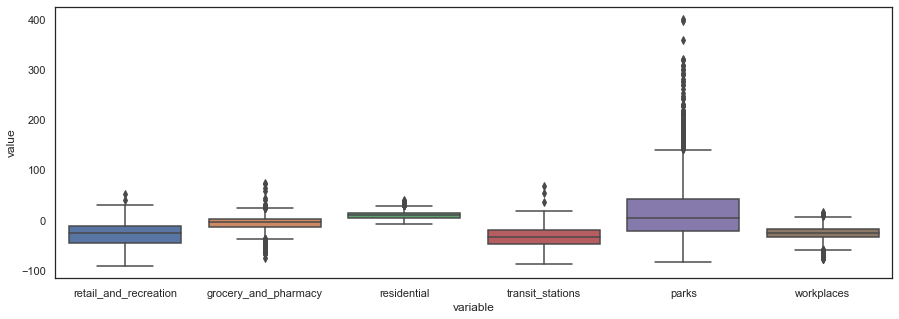

In [141]:
plt.subplots(figsize=(15,5))
sns.set_theme(style="whitegrid")

df_trends=df[['retail_and_recreation', 'grocery_and_pharmacy',
       'residential', 'transit_stations', 'parks', 'workplaces']]

sns.boxplot(x="variable", y="value",data=pd.melt(df_trends))
plt.show()

* All variables tend to have a small range of variables
* Variables parks, grocery_and_pharmacy and workplaces contain significant outliers

### Mobility Trends Pairplot

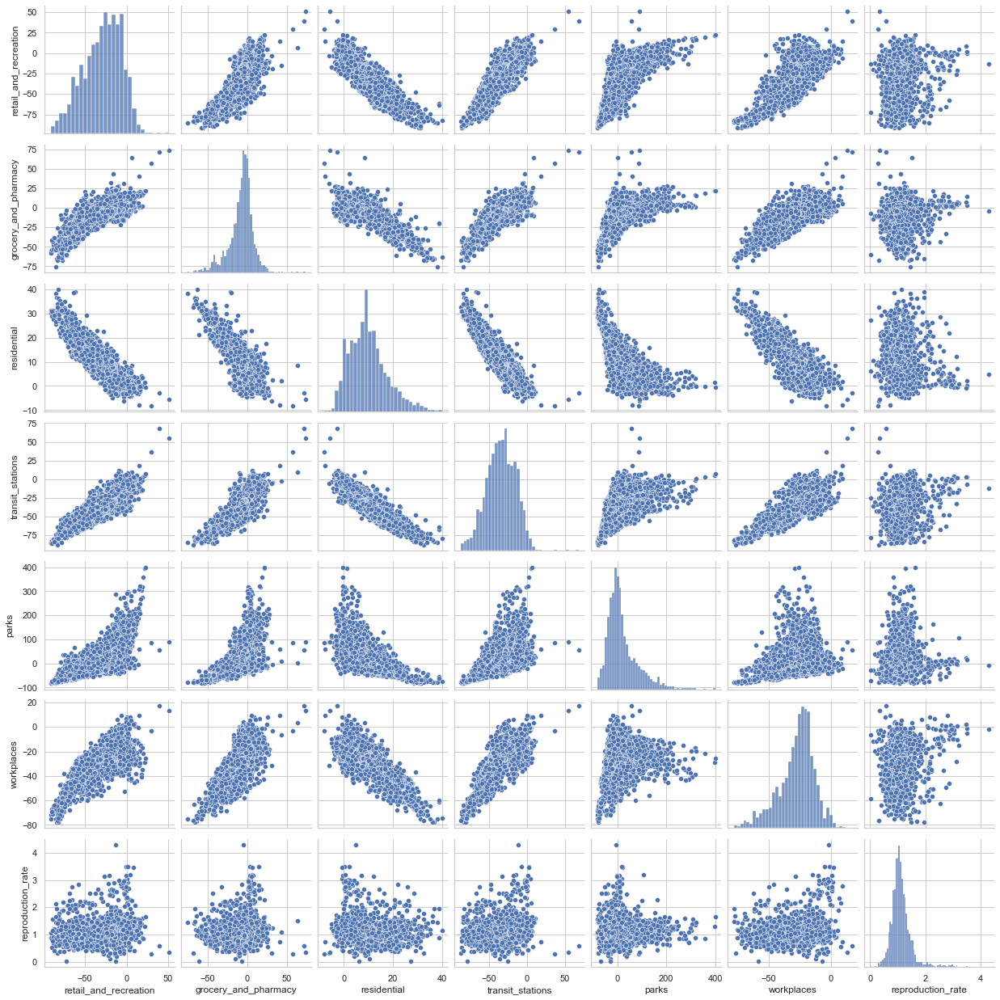

In [142]:
df_pairplot1=df[['retail_and_recreation', 'grocery_and_pharmacy',
       'residential', 'transit_stations', 'parks', 'workplaces', 'reproduction_rate']]
sns.pairplot(df_pairplot1)

* All mobility trends tend to be highly correlated negatively or positively.
* Multicollinearity between mobility trends
* The distribution in most mobility trends tends to be slighty positevly and negatively skewed  sepcially grocery_and_pharmacy and parks

### Restrictions Relation with reproduction rate

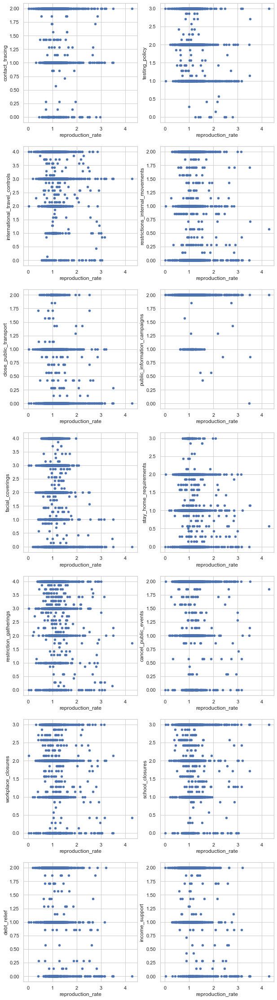

In [143]:
df_restrictions=df[['contact_tracing', 'testing_policy', 'international_travel_controls',
       'restrictions_internal_movements', 'close_public_transport',
       'public_information_campaigns', 'facial_coverings',
       'stay_home_requirements', 'restriction_gatherings',
       'cancel_public_events', 'workplace_closures', 'school_closures',
       'debt_relief', 'income_support']]

fig, axes = plt.subplots(7,2, figsize=(10, 40))

row=0
column=0
for restriction in df_restrictions.columns:
    df_pairplot_aux=df[[str(restriction), 'reproduction_rate']]
    
    df_pairplot_aux.plot.scatter(x='reproduction_rate',
        y=restriction,
        ax=axes[row][column])
    if(column==1):
        row = row + 1
    column = (column+1) % 2

* Reproduction rate is higher with strict restrictions and lower with flexible restrictions
* Debt relief, stay home requierements and facial coverings are the restrictions that seem to affect reproduction rate the most

### Accumulated deaths

<ipython-input-144-5ba10767ce64>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_acc['Date'] = pd.to_datetime(df_acc['Date'])


<AxesSubplot:xlabel='Date'>

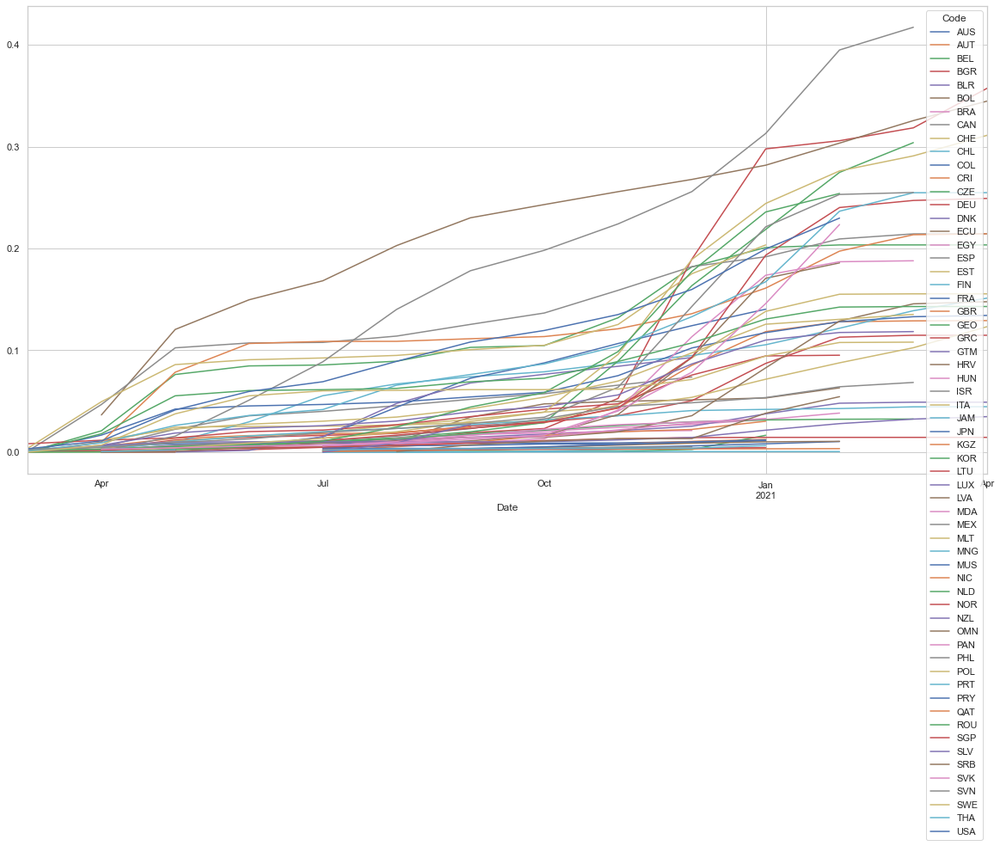

In [144]:
df_acc=df[['Code', 'Date', 'accumulated']]
df_acc['Date'] = pd.to_datetime(df_acc['Date'])
df_acc=df_acc.groupby(by=[df_acc['Date'].dt.to_period('m'), df_acc['Code']]).mean().reset_index()
df_acc=df_acc.pivot(index="Date",columns="Code",values="accumulated")
df_acc.plot()

* We can see the different "waves" through time March-April and November-December
* Special increase of accumulated deaths around March-April and October-November 2020 and January 2021
* Accumulated deaths seem to be stabilized after February
* There are is significantly less data from January 2021

In [145]:
alt.Chart(df).mark_point().encode(
    x='accumulated',
    y='reproduction_rate'
)

alt.Chart(...)

* We can clearly see a relation between accumulated deaths and reproduction rate. Accumulated also serves as proy variable of accumulated inmunity. It can be clearly seen that when accumulated cases are close to 0 reproduction rate ranges between 0 and 4.25
* Once accumulated is over 0.15 it can be clearly appreciated how reproduction rate tends to stabalize towards 1.
* It seems like government restrictions aim to find a reprodcution rate of 1.

### Infections value

In [146]:
alt.Chart(df).mark_point().encode(
    x='infections_value',
    y='reproduction_rate'
)

alt.Chart(...)

* Apparently the only relation between infections_value and reproduction rate is that as infection_value increases reproduction rate tends to be stabalized towards 1, this might be due to governments applying restrictions, when there are high values of infected people recorded.

### Vaccinations

<ipython-input-156-34fea4085abf>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_acc['Date'] = pd.to_datetime(df_acc['Date'])


<AxesSubplot:xlabel='Date'>

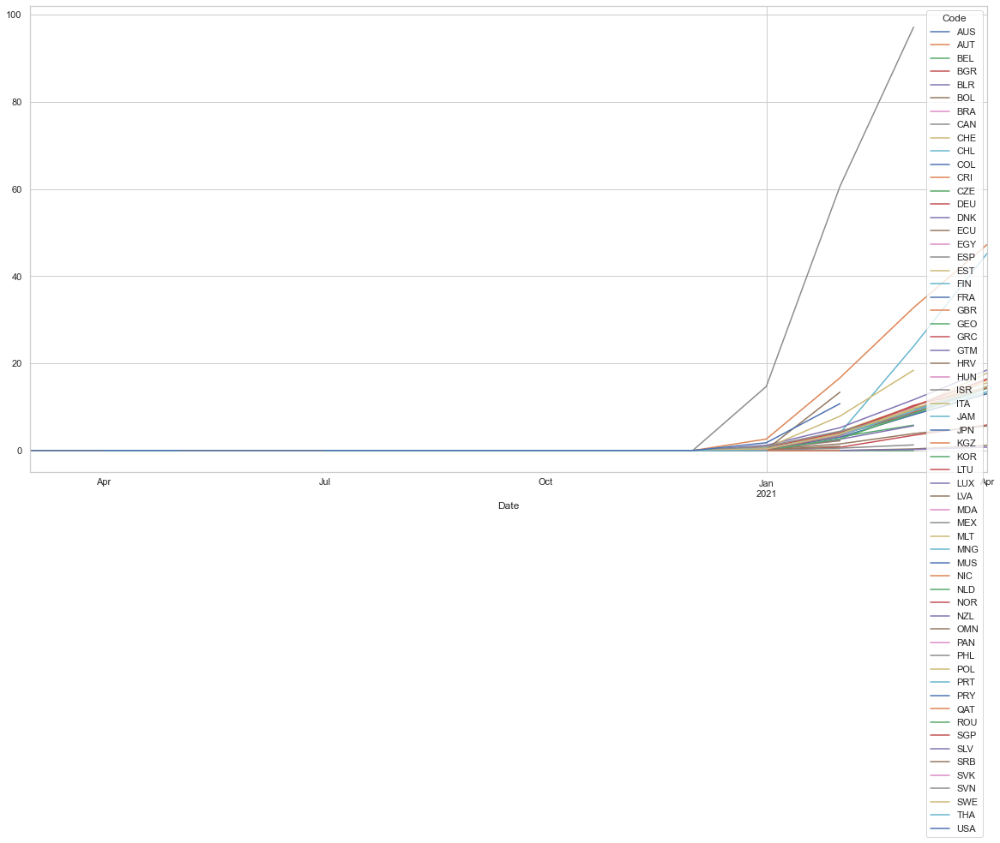

In [156]:
df_acc=df[['Code', 'Date', 'total_vaccinations_per_100']]
df_acc['Date'] = pd.to_datetime(df_acc['Date'])
df_acc=df_acc.groupby(by=[df_acc['Date'].dt.to_period('m'), df_acc['Code']]).mean().reset_index()
df_acc=df_acc.pivot(index="Date",columns="Code",values="total_vaccinations_per_100")
df_acc.plot()

* Vaccinations tend to have values form February 2021 forward in almost all countries. This will be complicated for our specific case since, our model may not be able to include such variable due to lack o information in most of the dataset, and small effect in our target variable due to unseen effect on number of positive cases. The effect of such variable might have bigger impact on number of deaths, since vaccine doses are at first administered to elderly people who are more prone on dying of covid-19.

In [155]:
alt.Chart(df).mark_point().encode(
    x='total_vaccinations_per_100',
    y='reproduction_rate'
)

alt.Chart(...)

* Vaccinations with values close to 0 are related with high values of reproduction_rate, once vaccination is included reproduction rate values tend to be between 1.5 and 0.5. This is due to the fact that reproduction rares have generally be wildly stabilized and its range of values has decreased over time.

### Number of arrivals per country

In [147]:
num_of_arrivals=df[['Code','number_of_arrivals']]
num_of_arrivals=num_of_arrivals.groupby(by=[num_of_arrivals['Code']]).mean().reset_index().sort_values('number_of_arrivals')

num_of_arrivals_plot = alt.Chart(num_of_arrivals).mark_bar().encode(color='Code',
    x=alt.X('Code',
            sort=alt.Sort(field='number_of_arrivals',
                         order='descending')
    ),
    y='number_of_arrivals',
    tooltip='Code'
).properties(
    width=800
)
num_of_arrivals_plot

alt.Chart(...)

* At first sight we can see that countries with higher number of arrivals are countries that have been most affected by Covid-19. Countries such us France, Usa, Spain, Italy, Great Britain or Germany.
* This data refers to tourists arrival per country, therefore it also reveals the mobility and iteration of population inside the country. Such value may be helpful to indicate those countries that are more prominent on having an uncontroled reproduction rate.

In [148]:
alt.Chart(df).mark_point().encode(color='Code',
    x='number_of_arrivals',
    y='reproduction_rate'
)

alt.Chart(...)

* We can see that countries with less than 20 million arrivals do have some high reproduction rates around 2.5, however very few countries with number of arrivals higher than 20 million seem to have a lot more reproduction rate appereances of values higher than 2.5 in proportion. 

### Youth unemployment per country

In [149]:
youth_unemployment_df=df[['Code','youth_unemployment']]

youth_unemployment_df=youth_unemployment_df.groupby(by=[youth_unemployment_df['Code']])\
                                 .mean().reset_index().sort_values('youth_unemployment')

youth_unemployment_df_plot = alt.Chart(youth_unemployment_df).mark_bar().encode(color='Code',
    x=alt.X('Code',sort=alt.Sort(field='youth_unemployment',order='descending')),
    y='youth_unemployment',
    tooltip='Code').properties(width=800)
youth_unemployment_df_plot

alt.Chart(...)

* Same case as with number of arrivals but a little less indicative. We can see some of the most affected countries by covid-19 on the top, Spain and Italy. Youth unemployment might have relation with the spread of te virus, since it has been pointed out youth as a source of spread.

### Urban population

In [150]:
urbanization_df=df[['Code','urban_population']]

urbanization_df=urbanization_df.groupby(by=[urbanization_df['Code']])\
                                 .mean().reset_index().sort_values('urban_population')

urbanization_df = alt.Chart(urbanization_df).mark_bar().encode(color='Code',
    x=alt.X('Code',sort=alt.Sort(field='urban_population',order='descending')),
    y='urban_population',
    tooltip='Code').properties(width=800)
urbanization_df

alt.Chart(...)

* Countries with highest values of urbanization are Singapore, Qatar and Belgium. 
* Apparently there are is no significant correlation between urban_population and reproduction_rate, based on countries most affected recorded.

### Temperature and Precipitation

/opt/anaconda3/lib/python3.8/site-packages/seaborn/relational.py:929: UserWarning: relplot is a figure-level function and does not accept the ax= paramter. You may wish to try scatterplot
  warnings.warn(msg, UserWarning)


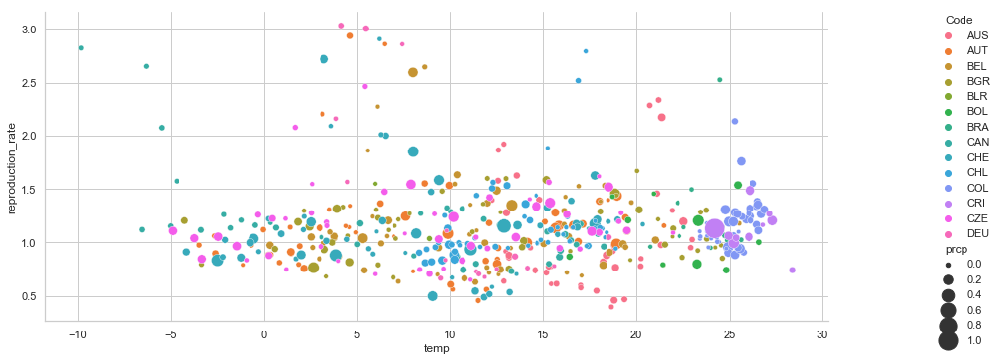

In [151]:
df['year']=pd.to_datetime(df['Date']).dt.year
g = sns.relplot(
    data=df.head(500),
    x="temp", y="reproduction_rate",size="prcp", hue="Code", sizes=(20, 400), ax=ax
)
g.fig.set_size_inches(15,5)

In [152]:
alt.Chart(df).mark_point().encode(
    x='temp',
    y='reproduction_rate'
)

alt.Chart(...)

* As seen on the graph, there seems to be a tendency of high reproduction rates when temperatures range values 0 to 10.
* Very low temperatures and very high temperatures are also related with low rates of reproduction

In [153]:
alt.Chart(df).mark_point().encode(
    x='prcp',
    y='reproduction_rate'
)

alt.Chart(...)

* It can be appreciated that when precipitation ranges high values reproduction rates seem to vanish.
* In the other hand most abnormal and high values of reproduction rate seem to be related with low values of precipitation.

## Conclusions

* Our dataset after necessary null removal is composed of 2224 rows with 33 columns with information of 61 countries.
* Mobility trends and restrictions seem to have highest relations among all features with our target variable reproduction_rate.
* Youth unemployment and number of arrivals when sorted by countries do seem to have some kind of relation based on recorded data. Countries that have been most affected by covid-19 are associated with high values in youth unemployment and number of arrivals. However urban population does not seem to have the same effect. 
* Vaccinations values are seeing in the dataset from Febrarury 2021. 
* Multicollinearity has most to do with restrictions and mobility indexes, the reason behing it is that restrictions are applied at the same time, and mobility indexes also increase or decrease their values at the same time.
* Reproduction rate values tend to be stabalized and its range of values tends to increasingly be closer to 1 as time passes.
* reproduction_rate_week_n-1 has a collinearity of 0.9 with our target variable.